# Feature Engineering and Modeling

In [1]:
import gc
import time
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split

# Ignore all warnings
import warnings
warnings.filterwarnings('ignore')

In [67]:
# Check all avaliable files
from subprocess import check_output
print(check_output(["ls", "./"]).decode("utf8"))

3d-scatter-tupac-with-mac.html
AskWhai Data Challenge.ipynb
D3 Tree Map
EDA-Insights.ipynb
Feature Engineering and Modeling.ipynb
aisles.csv
da_count.csv
da_order.csv
depart_aisle_count.csv
depart_aisle_order.csv
departments.csv
mydf.csv
order_products__prior.csv
order_products__test_cap.csv
order_products__train_cap.csv
orders.csv
products.csv
products_new.csv
summary.csv
train_data.csv
treemap_order.png
treemap_products.png
user_all.csv
users.csv



In [33]:
# Readin the data
order_products_train = pd.read_csv('./order_products__train_cap.csv')
order_products_test = pd.read_csv('./order_products__test_cap.csv')
order_products_prior = pd.read_csv('./order_products__prior.csv')
orders = pd.read_csv('./orders.csv')
products = pd.read_csv('./products.csv')
aisles = pd.read_csv('./aisles.csv')
departments = pd.read_csv('./departments.csv')

In [34]:
print("The shape of train data: ", order_products_train.shape)
print("The shape of test data: ", order_products_test.shape)
print("The shape of prior data: ", order_products_prior.shape)
print("The shape of orders data: ", .shape)
print("The shape of products data: ", products.shape)
print("The shape of aisles data: ", aisles.shape)
print("The shape of departments data: ", departments.shape)

The shape of train data:  (1038515, 4)
The shape of test data:  (346102, 2)
The shape of prior data:  (32434489, 4)
The shape of orders data:  (3421083, 7)
The shape of products data:  (49688, 4)
The shape of aisles data:  (134, 2)
The shape of departments data:  (21, 2)


In [125]:
print("Unique orders in the test data set: ", len(set(order_products_test.order_id)))

Unique orders in the test data set:  32803


In [37]:
order_products_prior.head()

,order_id,product_id,add_to_cart_order,reordered
0,2,33120,1,1
1,2,28985,2,1
2,2,9327,3,0
3,2,45918,4,1
4,2,30035,5,0


In [38]:
orders.head()

,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,2539329,1,prior,1,2,8,NaN
1,2398795,1,prior,2,3,7,15.0
2,473747,1,prior,3,3,12,21.0
3,2254736,1,prior,4,4,7,29.0
4,431534,1,prior,5,4,15,28.0


In [18]:
products = pd.merge(products, aisles, on='aisle_id', how='left')
products = pd.merge(products, departments, on='department_id', how='left')
products.head()

,product_id,product_name,aisle_id,department_id,aisle_x,aisle_y,department
0,1,Chocolate Sandwich Cookies,61,19,cookies cakes,cookies cakes,snacks
1,2,All-Seasons Salt,104,13,spices seasonings,spices seasonings,pantry
2,3,Robust Golden Unsweetened Oolong Tea,94,7,tea,tea,beverages
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen meals,frozen meals,frozen
4,5,Green Chile Anytime Sauce,5,13,marinades meat preparation,marinades meat preparation,pantry


In [39]:
# Merge order_products_prior and orders on order_id
order_products_prior_detail = orders.merge(right=order_products_prior, how='inner', on='order_id')

In [40]:
order_products_prior_detail.shape

(32434489, 10)

In [20]:
# Sort the datafram ascending on order number 
order_products_prior_detail = order_products_prior_detail.sort_values(["user_id", "order_number","product_id"], ascending = (True, True, True))
# Create a new variable -- user_product_time: count how many times user buy the product before on each order
order_products_prior_detail.loc[:,'user_product_time'] = order_products_prior_detail.groupby(['user_id', 'product_id']).cumcount()

In [21]:
order_products_prior_detail.head()

,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_id,add_to_cart_order,reordered,user_product_time
0,2539329,1,prior,1,2,8,NaN,196,1,0,0
2,2539329,1,prior,1,2,8,NaN,12427,3,0,0
1,2539329,1,prior,1,2,8,NaN,14084,2,0,0
3,2539329,1,prior,1,2,8,NaN,26088,4,0,0
4,2539329,1,prior,1,2,8,NaN,26405,5,0,0


In [28]:
print("The maximum value of the times user buy a porduct is ", max(order_products_prior_detail.user_product_time))

The maximum value of the times user buy a porduct is  98


In [38]:
print("The average value of the times user buy a porduct is ", sum(order_products_prior_detail.user_product_time)/len(order_products_prior_detail.user_product_time))

The average value of the times user buy a porduct is  3.3106305143268946


In [42]:
products_new = order_products_prior_detail.groupby(['product_id']).agg({'user_id':{'product_total':'count'}, 
      'reordered':{'product_reorder':'sum'}, 
      'user_product_time': {'product_first_order':lambda x: sum(x==1),
                            'product_second_order':lambda x: sum(x==2),
                            'product_third_order':lambda x: sum(x==3),}})

In [43]:
products_new.head()

user_id       reordered   user_product_time  \
           product_total product_reorder product_first_order   
product_id                                                     
1                   1852            1136                 276   
2                     90              12                   8   
3                    277             203                  36   
4                    329             147                  64   
5                     15               9                   4   

                                                     
           product_second_order product_third_order  
product_id                                           
1                           174                 115  
2                             1                   1  
3                            24                  21  
4                            33                  15  
5                             1                   1

In [44]:
# Adjust the column names and reindexing rows.
products_new.columns = products_new.columns.droplevel(0)
products_new.reset_index(inplace=True)
products_new.head()

,product_id,product_total,product_reorder,product_first_order,product_second_order,product_third_order
0,1,1852,1136,276,174,115
1,2,90,12,8,1,1
2,3,277,203,36,24,21
3,4,329,147,64,33,15
4,5,15,9,4,1,1


In [46]:
products_new.shape

(49677, 6)

In [48]:
# Creat some new variables: 
products_new['product_reorder_pro'] = products_new.product_second_order / products_new.product_first_order
products_new['product_triorder_pro'] = products_new.product_third_order / products_new.product_second_order
products_new['product_reorder_ratio'] = products_new.product_reorder / products_new.product_total
products_new['product_reorder_times'] = 1 + products_new.product_reorder / products_new.product_first_order

In [50]:
products_new.head()

,product_id,product_total,product_reorder,product_first_order,product_second_order,product_third_order,product_reorder_pro,product_triorder_pro,product_reorder_ratio,product_reorder_times
0,1,1852,1136,276,174,115,0.630435,0.660920,0.613391,5.115942
1,2,90,12,8,1,1,0.125000,1.000000,0.133333,2.500000
2,3,277,203,36,24,21,0.666667,0.875000,0.732852,6.638889
3,4,329,147,64,33,15,0.515625,0.454545,0.446809,3.296875
4,5,15,9,4,1,1,0.250000,1.000000,0.600000,3.250000


In [49]:
products_new.to_csv("products_new.csv")

### Create new User factors:

In [41]:
order_products_prior_detail.head()

,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_id,add_to_cart_order,reordered
0,2539329,1,prior,1,2,8,NaN,196,1,0
1,2539329,1,prior,1,2,8,NaN,14084,2,0
2,2539329,1,prior,1,2,8,NaN,12427,3,0
3,2539329,1,prior,1,2,8,NaN,26088,4,0
4,2539329,1,prior,1,2,8,NaN,26405,5,0


In [104]:
user_1 = order_products_prior_detail.groupby(['user_id']).agg(
    {'order_number':{'user_total_order':'max'},
      'days_since_prior_order':{'user_days_since_prior_sum':'sum', 
                                'user_days_since_prior_avg': 'mean'}})

In [60]:
user_1.head()

order_number    days_since_prior_order                          
        user_total_order user_days_since_prior_sum user_days_since_prior_avg
user_id                                                                     
1                     10                    1094.0                 20.259259
2                     14                    2906.0                 15.967033
3                     12                     896.0                 11.487179
4                      5                     215.0                 15.357143
5                      4                     377.0                 14.500000

In [105]:
user_2 = order_products_prior_detail.groupby(['user_id']).agg(
    {'reordered':{'user_reorder_ratio': lambda x: sum(order_products_prior_detail.ix[x.index,'reordered']==1)/
                                                   sum(order_products_prior_detail.ix[x.index,'order_number'] > 1)},
     'product_id':{'user_total_products':'count', 
                   'user_distinct_products': lambda x: x.nunique()}})

In [57]:
user_2.head()

reordered          product_id                       
        user_reorder_ratio user_total_products user_distinct_products
user_id                                                              
1                 0.759259                  59                     18
2                 0.510989                 195                    102
3                 0.705128                  88                     33
4                 0.071429                  18                     17
5                 0.538462                  37                     23

In [106]:
users = user_1.merge(user_2, how='inner',  on='user_id')
users.head()

order_number    days_since_prior_order                            \
        user_total_order user_days_since_prior_sum user_days_since_prior_avg   
user_id                                                                        
1                     10                    1094.0                 20.259259   
2                     14                    2906.0                 15.967033   
3                     12                     896.0                 11.487179   
4                      5                     215.0                 15.357143   
5                      4                     377.0                 14.500000   

                 reordered          product_id                         
        user_reorder_ratio user_total_products user_distinct_products  
user_id                                                                
1                 0.759259                  59                     18  
2                 0.510989                 195                    102  
3                 0.705128                  88                     33  
4                 0.071429                  18                     17  
5                 0.538462                  37                     23

In [107]:
# Adjust the column names and reindexing rows.
users.columns = users.columns.droplevel(0)
users.reset_index(inplace=True)
users.head()

,user_id,user_total_order,user_days_since_prior_sum,user_days_since_prior_avg,user_reorder_ratio,user_total_products,user_distinct_products
0,1,10,1094.0,20.259259,0.759259,59,18
1,2,14,2906.0,15.967033,0.510989,195,102
2,3,12,896.0,11.487179,0.705128,88,33
3,4,5,215.0,15.357143,0.071429,18,17
4,5,4,377.0,14.500000,0.538462,37,23


In [108]:
users.shape

(206209, 7)

In [109]:
#users.to_csv('user_all.csv')

In [67]:
order_select = orders[orders.eval_set != "prior"][['user_id', 'order_id', 'eval_set', 'days_since_prior_order']]
users = users.merge(order_select, how='inner', on = 'user_id')
users.head()

,user_id,user_total_order,user_days_since_prior_sum,user_days_since_prior_avg,user_reorder_ratio,user_total_products,user_distinct_products,order_id,eval_set,days_since_prior_order
0,1,10,1094.0,20.259259,0.759259,59,18,1187899,train,14.0
1,2,14,2906.0,15.967033,0.510989,195,102,1492625,train,30.0
2,3,12,896.0,11.487179,0.705128,88,33,2774568,test,11.0
3,4,5,215.0,15.357143,0.071429,18,17,329954,test,30.0
4,5,4,377.0,14.500000,0.538462,37,23,2196797,train,6.0


In [68]:
users.to_csv("users.csv")

## User Cluster Analysis:

In [128]:
users = pd.read_csv("user_all.csv")
users.columns

Index(['Unnamed: 0', 'user_id', 'user_total_order',
       'user_days_since_prior_sum', 'user_days_since_prior_avg',
       'user_reorder_ratio', 'user_total_products', 'user_distinct_products'],
      dtype='object')

In [130]:
users.drop(['Unnamed: 0','user_id'],axis=1, inplace=True)

In [133]:
users.head()

,user_total_order,user_days_since_prior_sum,user_days_since_prior_avg,user_reorder_ratio,user_total_products,user_distinct_products
0,10,1094.0,20.259259,0.759259,59,18
1,14,2906.0,15.967033,0.510989,195,102
2,12,896.0,11.487179,0.705128,88,33
3,5,215.0,15.357143,0.071429,18,17
4,4,377.0,14.500000,0.538462,37,23


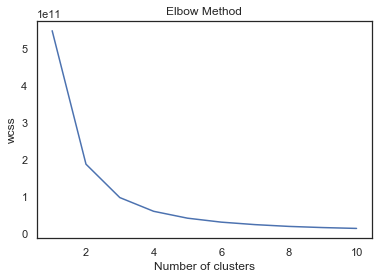

In [131]:
#Using the elbow method to find the optimum number of clusters
from sklearn.cluster import KMeans
wcss = []
for i in range(1,11):
    km=KMeans(n_clusters=i,init='k-means++', max_iter=300, n_init=10, random_state=123)
    km.fit(users)
    wcss.append(km.inertia_)
plt.plot(range(1,11),wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('wcss')
plt.show()

In [134]:
##Fitting kmeans to the dataset with k=4
km4=KMeans(n_clusters=4,init='k-means++', max_iter=300, n_init=10, random_state=0)
y_means = km4.fit_predict(users)

In [144]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
x = users.values
x = StandardScaler().fit_transform(x)

pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x)
result = pd.DataFrame(data = principalComponents
             , columns = ['PCA0', 'PCA1','PCA2'])

In [153]:
from plotly.offline import plot
import plotly.graph_objs as go
pca = PCA(n_components=3).fit(x)
X_reduced = pca.transform(x)
trace1 = go.Scatter3d(
    x=X_reduced[:,0],
    y = X_reduced[:,1],
    z = X_reduced[:,2],
    mode='markers',
    marker=dict(
        size=12,
        color= y_means,                
        opacity=1
)

)

dc_1 = go.Scatter3d( x = [0,pca.components_.T[0][0]],
                     y = [0,pca.components_.T[0][1]],
                     z = [0,pca.components_.T[0][2]],
                     marker = dict( size = 1,
                                    color = "rgb(84,48,5)"),
                     line = dict( color = "red",
                                width = 6),
                     name = "Var1"
                     )
dc_2 = go.Scatter3d( x = [0,pca.components_.T[1][0]],
                   y = [0,pca.components_.T[1][1]],
                   z = [0,pca.components_.T[1][2]],
                   marker = dict( size = 1,
                                  color = "rgb(84,48,5)"),
                   line = dict( color = "green",
                                width = 6),
                   name = "Var2"
                 )
dc_3 = go.Scatter3d( x = [0,pca.components_.T[2][0]],
                     y = [0,pca.components_.T[2][1]],
                     z = [0,pca.components_.T[2][2]],
                     marker = dict( size = 1,
                                  color = "rgb(84,48,5)"),
                     line = dict( color = "blue",
                                width = 6),
                     name = "Var3"
                 ) 
dc_4 = go.Scatter3d( x = [0,pca.components_.T[3][0]],
                     y = [0,pca.components_.T[3][1]],
                     z = [0,pca.components_.T[3][2]],
                     marker = dict( size = 1,
                                  color = "rgb(84,48,5)"),
                     line = dict( color = "yellow",
                                width = 6),
                     name = "Var4"
                   )


data = [trace1,dc_1,dc_2,dc_3,dc_4]
layout = go.Layout(
    xaxis=dict(
        title='PC1',
        titlefont=dict(
           family='Courier New, monospace',
           size=18,
           color='#7f7f7f'
       )
   )
)
fig = go.Figure(data=data, layout=layout)
fig.show()
#plot(fig, filename='3d-scatter-tupac-with-mac')

In [140]:
principalDf = principalDf.to_numpy()

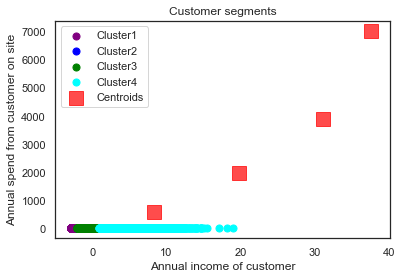

In [141]:
#Visualizing the clusters for k=4
plt.scatter(principalDf[y_means==0,0],principalDf[y_means==0,1],s=50, c='purple',label='Cluster1')
plt.scatter(principalDf[y_means==1,0],principalDf[y_means==1,1],s=50, c='blue',label='Cluster2')
plt.scatter(principalDf[y_means==2,0],principalDf[y_means==2,1],s=50, c='green',label='Cluster3')
plt.scatter(principalDf[y_means==3,0],principalDf[y_means==3,1],s=50, c='cyan',label='Cluster4')
plt.scatter(km4.cluster_centers_[:,0], km4.cluster_centers_[:,1],s=200,marker='s', c='red', alpha=0.7, label='Centroids')
plt.title('Customer segments')
plt.xlabel('Annual income of customer')
plt.ylabel('Annual spend from customer on site')
plt.legend()
plt.show()

In [154]:
users.columns

Index(['user_total_order', 'user_days_since_prior_sum',
       'user_days_since_prior_avg', 'user_reorder_ratio',
       'user_total_products', 'user_distinct_products'],
      dtype='object')

In [156]:
users['cluster'] = y_means
users.groupby('cluster')['user_total_order'].describe()

,count,mean,std,min,25%,50%,75%,max
cluster,,,,,,,,
0,113624.0,8.306441,8.646603,3.0,4.0,6.0,9.0,99.0
1,27476.0,31.048661,20.471980,3.0,16.0,25.0,41.0,99.0
2,57919.0,19.816433,17.356204,3.0,9.0,14.0,24.0,99.0
3,7190.0,37.583032,19.146513,5.0,23.0,34.0,49.0,99.0


In [160]:
cluster_summary = users.groupby('cluster').agg(
      {'user_total_order':{'user_total_order_mean': 'mean'}, 
       'user_days_since_prior_avg':{'user_days_since_prior_avg_mean': 'mean'},
       'user_reorder_ratio':{'user_reorder_ratio_mean': 'mean'},
       'user_total_products':{'user_total_products_mean': 'mean'},
       'user_distinct_products':{'user_distinct_products_mean': 'mean'}
      })

In [163]:
cluster_summary.columns = cluster_summary.columns.droplevel(0)
cluster_summary

,user_total_order_mean,user_days_since_prior_avg_mean,user_reorder_ratio_mean,user_total_products_mean,user_distinct_products_mean
cluster,,,,,
0,8.306441,16.421431,0.417068,52.305613,31.243655
1,31.048661,12.918222,0.640928,393.184343,135.843718
2,19.816433,15.312910,0.530678,176.518828,79.308224
3,37.583032,11.441858,0.732507,759.998470,199.169541


### Create a Data Set to train:

In [99]:
order_products_prior_detail.head()

,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_id,add_to_cart_order,reordered
0,2539329,1,prior,1,2,8,NaN,196,1,0
1,2539329,1,prior,1,2,8,NaN,14084,2,0
2,2539329,1,prior,1,2,8,NaN,12427,3,0
3,2539329,1,prior,1,2,8,NaN,26088,4,0
4,2539329,1,prior,1,2,8,NaN,26405,5,0


In [100]:
unique, counts = np.unique(order_products_prior_detail.eval_set, return_counts=True)
dict(zip(unique, counts))

{'prior': 32434489}

In [22]:
users = pd.read_csv("users.csv")
products_new = pd.read_csv("products_new.csv")

In [26]:
mydf = order_products_prior_detail.groupby(['user_id','product_id']).agg(
      {'order_number':{'user_product_order_count': 'count', 
                       'user_product_first_order': 'min', 
                       'user_product_last_order':'max'}, 
       'add_to_cart_order':{'user_product_avg_cart_position': 'mean'}})

In [27]:
mydf.head()

order_number                           \
                   user_product_order_count user_product_first_order   
user_id product_id                                                     
1       196                              10                        1   
        10258                             9                        2   
        10326                             1                        5   
        12427                            10                        1   
        13032                             3                        2   

                                                        add_to_cart_order  
                   user_product_last_order user_product_avg_cart_position  
user_id product_id                                                         
1       196                             10                       1.400000  
        10258                           10                       3.333333  
        10326                            5                       5.000000  
        12427                           10                       3.300000  
        13032                           10                       6.333333

In [28]:
# Adjust the column names and reindexing rows.
mydf.columns = mydf.columns.droplevel(0)
mydf.reset_index(inplace=True)
mydf.head()

,user_id,product_id,user_product_order_count,user_product_first_order,user_product_last_order,user_product_avg_cart_position
0,1,196,10,1,10,1.400000
1,1,10258,9,2,10,3.333333
2,1,10326,1,5,5,5.000000
3,1,12427,10,1,10,3.300000
4,1,13032,3,2,10,6.333333


In [29]:
mydf.tail()

,user_id,product_id,user_product_order_count,user_product_first_order,user_product_last_order,user_product_avg_cart_position
13307948,206209,43961,3,4,12,8.0
13307949,206209,44325,1,7,7,8.0
13307950,206209,48370,1,11,11,8.0
13307951,206209,48697,1,7,7,6.0
13307952,206209,48742,2,7,12,9.0


In [30]:
mydf = mydf.merge(products_new, how='inner', on='product_id').merge(users, how='inner', on='user_id')

In [31]:
mydf.columns

Index(['user_id', 'product_id', 'user_product_order_count',
       'user_product_first_order', 'user_product_last_order',
       'user_product_avg_cart_position', 'Unnamed: 0_x', 'product_total',
       'product_reorder', 'product_first_order', 'product_second_order',
       'product_third_order', 'product_reorder_pro', 'product_triorder_pro',
       'product_reorder_ratio', 'product_reorder_times', 'Unnamed: 0_y',
       'user_total_order', 'user_days_since_prior_sum',
       'user_days_since_prior_avg', 'user_reorder_ratio',
       'user_total_products', 'user_distinct_products', 'order_id', 'eval_set',
       'days_since_prior_order'],
      dtype='object')

In [32]:
mydf['user_product_order_rate'] = mydf.user_product_order_count / mydf.user_total_order
mydf['user_product_order_since_last_order'] = mydf.user_total_order - mydf.user_product_last_order
mydf['user_product_order_rate_since_first_order'] = mydf.user_product_order_count / (mydf.user_total_order - mydf.user_product_first_order + 1)

In [3]:
#mydf.to_csv("mydf.csv")
mydf = pd.read_csv('mydf.csv')

In [5]:
# add user_id to train set
order_products_train = pd.read_csv('./order_products__train_cap.csv')
train_data = order_products_train.merge(right=orders[['order_id', 'user_id']], how='left', on='order_id')
train_data = train_data.merge(mydf, how = 'left', on = ['user_id','product_id'])
train_data.head()

,order_id_x,product_id,add_to_cart_order,reordered,user_id,Unnamed: 0,user_product_order_count,user_product_first_order,user_product_last_order,user_product_avg_cart_position,...,user_days_since_prior_avg,user_reorder_ratio,user_total_products,user_distinct_products,order_id_y,eval_set,days_since_prior_order,user_product_order_rate,user_product_order_since_last_order,user_product_order_rate_since_first_order
0,36,39612,1,0,79431,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,36,19660,2,1,79431,8701148.0,15.0,2.0,21.0,4.733333,...,17.179775,0.483146,187.0,101.0,36.0,train,30.0,0.681818,1.0,0.714286
2,36,49235,3,0,79431,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,36,43086,4,1,79431,8701118.0,3.0,5.0,8.0,7.000000,...,17.179775,0.483146,187.0,101.0,36.0,train,30.0,0.136364,14.0,0.166667
4,36,46620,5,1,79431,8701176.0,1.0,15.0,15.0,5.000000,...,17.179775,0.483146,187.0,101.0,36.0,train,30.0,0.045455,7.0,0.125000


In [7]:
orders = pd.read_csv('orders.csv')
order_products_train = pd.read_csv('./order_products__train_cap.csv')
# add user_id to train set
train = order_products_train.merge(right=orders[['order_id', 'user_id']], how='left', on='order_id')
data = mydf.merge(train[['user_id', 'product_id', 'reordered']], on=['user_id', 'product_id'], how='left')



In [8]:
train = data.loc[data.eval_set == "train",:]
train.drop(['eval_set', 'user_id', 'product_id', 'order_id'], axis=1, inplace=True)
train.loc[:, 'reordered'] = train.reordered.fillna(0)

X_test = data.loc[data.eval_set == "test",:]

In [9]:
train = train.fillna(0)

In [12]:
train.to_csv("train_data.csv")

# Train Model:

In [2]:
import numpy as np
from scipy import interp
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve
from sklearn.model_selection import StratifiedKFold
from xgboost import XGBClassifier
from sklearn.preprocessing import scale
import matplotlib as mpl

In [3]:
my_data = pd.read_csv("train_data.csv")

In [4]:
my_data.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'user_product_order_count',
       'user_product_first_order', 'user_product_last_order',
       'user_product_avg_cart_position', 'Unnamed: 0_x', 'product_total',
       'product_reorder', 'product_first_order', 'product_second_order',
       'product_third_order', 'product_reorder_pro', 'product_triorder_pro',
       'product_reorder_ratio', 'product_reorder_times', 'Unnamed: 0_y',
       'user_total_order', 'user_days_since_prior_sum',
       'user_days_since_prior_avg', 'user_reorder_ratio',
       'user_total_products', 'user_distinct_products',
       'days_since_prior_order', 'user_product_order_rate',
       'user_product_order_since_last_order',
       'user_product_order_rate_since_first_order', 'reordered'],
      dtype='object')

## Feature Explanation:

* ### Product Features:
    * **product_total:** count how many times the product being purchased, (measures how user like this product)
    * **product_reorder:** how many times the product is reordered
    * **product_first_order:** how many times the product is being bought by the user for one time
    * **product_second_order:**  how many times the product is being bought by the user for second time
    * **product_third_order:** how many times the product is being bought by the user for third time
    * **product_reorder_pro:** product_second_order/product_first_order
    * **product_triorder_pro:** product_third_order/product_second_order
    * **product_reorder_ratio:** product_reorder/product_total
    * **product_reorder_times:** product_reorder/product_first_order + 1


* ### User Features:
    * **user_total_order:** count how many orders the user has made	
    * **user_days_since_prior_sum:** sum of days_since_prior_order for each user.
    * **user_days_since_prior_avg:** average of days_since_prior_order for each user.
    * **user_reorder_ratio:** count of products that is reordered/ times the user buy this product after first order
    * **user_total_products:** how many products in total the user buy in previous order 
    * **user_distinct_products:** how many distinct product the user buy

* ### User Product Features:
    * **user_product_order_count:**  count how many times the product being purchased by each user.
    * **user_product_first_order:** the order number when the user buys this product for the first time.
    * **user_product_last_order:** the order number when the user buys this product for the last time.
    * **user_product_avg_cart_position:** the average position of the product for each order by the user.
    * **user_product_order_rate:** user_product_order_count/user_total_order
    * **user_product_order_since_last_order:** user_total_order - user_product_last_order
    * **user_product_order_rate_since_first_order:** user_product_order_count/ (user_total_order - user_product_first_order + 1)


In [5]:
my_data.drop(['Unnamed: 0','Unnamed: 0_y', 'Unnamed: 0_x'], axis=1, inplace=True)
my_data.loc[:, 'reordered'] = my_data.reordered.fillna(0)
my_data.shape

(8474661, 25)

In [80]:
my_data

,add_to_cart_order,reordered,user_product_order_count,user_product_first_order,user_product_last_order,user_product_avg_cart_position,product_total,product_reorder,product_first_order,product_second_order,...,user_total_order,user_days_since_prior_sum,user_days_since_prior_avg,user_reorder_ratio,user_total_products,user_distinct_products,days_since_prior_order,user_product_order_rate,user_product_order_since_last_order,user_product_order_rate_since_first_order
0,1,1,2.0,1.0,2.0,2.500000,163.0,101.0,27.0,19.0,...,3.0,131.0,10.076923,0.692308,21.0,12.0,9.0,0.666667,1.0,0.666667
1,2,1,2.0,1.0,2.0,4.000000,4472.0,3192.0,704.0,475.0,...,3.0,131.0,10.076923,0.692308,21.0,12.0,9.0,0.666667,1.0,0.666667
2,3,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,1,2.0,1.0,3.0,3.500000,653.0,312.0,114.0,59.0,...,3.0,131.0,10.076923,0.692308,21.0,12.0,9.0,0.666667,0.0,0.666667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1384612,3,1,18.0,3.0,28.0,7.166667,13727.0,10385.0,1901.0,1366.0,...,29.0,2173.0,6.964744,0.775641,325.0,83.0,4.0,0.620690,1.0,0.666667
1384613,4,1,7.0,1.0,22.0,9.142857,234.0,133.0,42.0,28.0,...,29.0,2173.0,6.964744,0.775641,325.0,83.0,4.0,0.241379,7.0,0.241379
1384614,1,1,5.0,1.0,13.0,2.400000,57895.0,43875.0,8244.0,5756.0,...,14.0,337.0,13.480000,0.760000,30.0,11.0,8.0,0.357143,1.0,0.357143
1384615,2,1,2.0,1.0,11.0,3.000000,20033.0,10503.0,3890.0,2078.0,...,14.0,337.0,13.480000,0.760000,30.0,11.0,8.0,0.142857,3.0,0.142857


### Correlation of variables:

In [17]:
cor_data = my_data.fillna(0)
cor_data = cor_data.apply(lambda x:x.astype(float))
pearsoncorr = cor_data.corr(method='pearson')
pearsoncorr

,user_product_order_count,user_product_first_order,user_product_last_order,user_product_avg_cart_position,product_total,product_reorder,product_first_order,product_second_order,product_third_order,product_reorder_pro,...,user_days_since_prior_sum,user_days_since_prior_avg,user_reorder_ratio,user_total_products,user_distinct_products,days_since_prior_order,user_product_order_rate,user_product_order_since_last_order,user_product_order_rate_since_first_order,reordered
user_product_order_count,1.000000,-0.104062,0.392848,-0.085359,0.163652,0.164391,0.159553,0.163026,0.164453,0.207747,...,0.190027,-0.170775,0.296853,0.247747,0.115526,-0.119306,0.468537,-0.114935,0.167993,0.211403
user_product_first_order,-0.104062,1.000000,0.738562,0.042440,-0.069022,-0.067503,-0.071412,-0.070777,-0.069833,-0.087458,...,0.267590,-0.423821,0.341008,0.487335,0.451345,-0.301349,-0.399019,0.092621,-0.101243,-0.066199
user_product_last_order,0.392848,0.738562,1.000000,-0.003463,0.018838,0.017170,0.021200,0.019788,0.018965,0.030032,...,0.368055,-0.530842,0.498615,0.652234,0.538644,-0.376042,-0.207686,0.035716,-0.125461,0.014941
user_product_avg_cart_position,-0.085359,0.042440,-0.003463,1.000000,-0.075160,-0.076009,-0.072121,-0.074237,-0.075200,-0.072948,...,0.413640,0.009839,0.162709,0.274168,0.280183,-0.014836,-0.120434,0.006756,-0.035163,-0.036382
product_total,0.163652,-0.069022,0.018838,-0.075160,1.000000,0.996233,0.983098,0.995171,0.998574,0.372614,...,-0.036158,0.028006,0.007918,-0.038010,-0.059814,0.015642,0.185549,-0.078812,0.100254,0.108490
product_reorder,0.164391,-0.067503,0.017170,-0.076009,0.996233,1.000000,0.964165,0.984409,0.993220,0.365184,...,-0.036779,0.027780,0.006246,-0.038165,-0.059018,0.015852,0.187029,-0.076504,0.101346,0.108388
product_first_order,0.159553,-0.071412,0.021200,-0.072121,0.983098,0.964165,1.000000,0.995382,0.987369,0.386243,...,-0.034981,0.028611,0.010143,-0.037856,-0.060880,0.015453,0.180405,-0.082655,0.097408,0.107248
product_second_order,0.163026,-0.070777,0.019788,-0.074237,0.995171,0.984409,0.995382,1.000000,0.997975,0.384035,...,-0.036119,0.028698,0.008629,-0.038473,-0.060868,0.015846,0.184920,-0.081272,0.100097,0.108843
product_third_order,0.164453,-0.069833,0.018965,-0.075200,0.998574,0.993220,0.987369,0.997975,1.000000,0.379753,...,-0.036527,0.028432,0.007844,-0.038495,-0.060432,0.015871,0.186644,-0.079879,0.101156,0.109246
product_reorder_pro,0.207747,-0.087458,0.030032,-0.072948,0.372614,0.365184,0.386243,0.384035,0.379753,1.000000,...,-0.023399,0.028898,0.047671,-0.027090,-0.066642,0.014690,0.223615,-0.082753,0.124861,0.127911


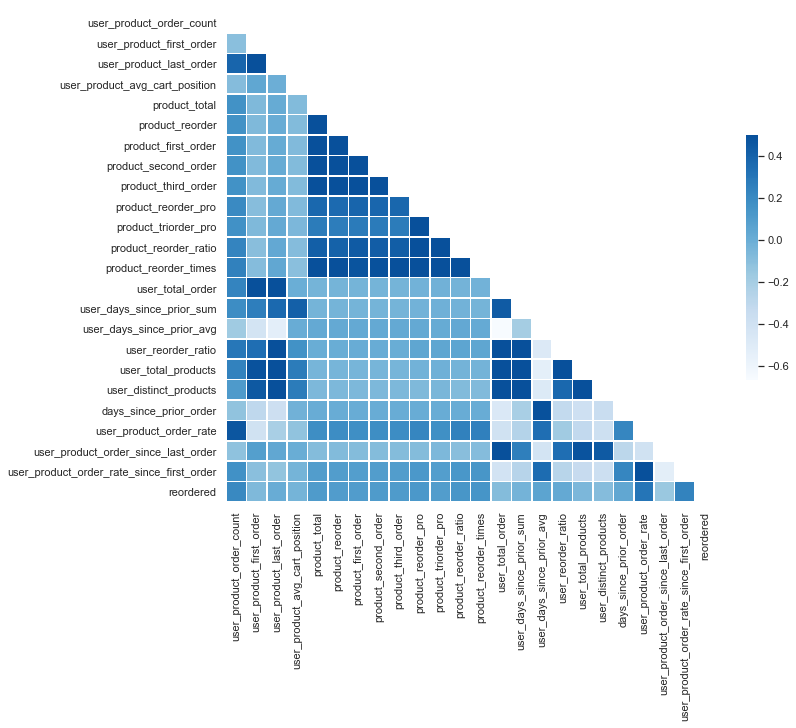

In [19]:
from string import ascii_letters
import seaborn as sns
import matplotlib.pyplot as plt

sns.set(style="white")

# Compute the correlation matrix
cor_data = my_data.fillna(0)
corr = cor_data.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap="Blues", vmax=0.5, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.show()

### Train model with Logistic Regression:

In [6]:
Xdata = my_data.drop(['reordered'], axis=1)
Ydata = my_data.reordered

In [7]:
Xdata.columns

Index(['Unnamed: 0.1', 'user_product_order_count', 'user_product_first_order',
       'user_product_last_order', 'user_product_avg_cart_position',
       'product_total', 'product_reorder', 'product_first_order',
       'product_second_order', 'product_third_order', 'product_reorder_pro',
       'product_triorder_pro', 'product_reorder_ratio',
       'product_reorder_times', 'user_total_order',
       'user_days_since_prior_sum', 'user_days_since_prior_avg',
       'user_reorder_ratio', 'user_total_products', 'user_distinct_products',
       'days_since_prior_order', 'user_product_order_rate',
       'user_product_order_since_last_order',
       'user_product_order_rate_since_first_order'],
      dtype='object')

In [8]:
y = Ydata.values
X = Xdata.values
unique, counts = np.unique(y, return_counts=True)
dict(zip(unique, counts))

{0.0: 7852735, 1.0: 621926}

In [56]:
X_train, X_val, y_train, y_val = train_test_split(Xdata,Ydata,test_size=0.8, random_state= 128)

In [14]:
X_train = X_train.fillna(0)
y_train = y_train.fillna(0)
X_val = X_val.fillna(0)
y_val = y_val.fillna(0)

In [15]:
unique, counts = np.unique(y_val, return_counts=True)
dict(zip(unique, counts))

{0.0: 6282140, 1.0: 497589}

In [16]:
#  X_train, X_val, y_train, y_val
from sklearn.linear_model import LogisticRegression
rgm = LogisticRegression()
probability_result = rgm.fit(X_train,y_train.ravel()).predict_proba(X_val)
predict = (probability_result [:,1] >= 0.5).astype('int')

accuracy = accuracy_score(y_val, predict)
print("Accuracy: %.6f%%" % (accuracy * 100.0))

Accuracy: 92.594011%


### Lasso Regression (Future Work)

lasso imposes an $L1$ penalty on the parameters 𝛽. That is, lasso finds an assignment to 𝛽 that minimizes the function:

$$
f(\beta) = \|X\beta - Y\|_2^2 + \lambda \|\beta\|_1,
$$

The $L1$ penalty encourages sparsity in the learned parameters, and, as we will see, can drive many coefficients to zero.

In [47]:
#!pip install cvxpy

In [43]:
def loss_fn(X, Y, beta):
    return cp.norm2(X @ beta - Y)**2

def regularizer(beta):
    return cp.norm1(beta)

def objective_fn(X, Y, beta, lambd):
    return loss_fn(X, Y, beta) + lambd * regularizer(beta)

def mse(X, Y, beta):
    return (1.0 / X.shape[0]) * loss_fn(X, Y, beta).value

In [50]:
def generate_data(m=100, n=20, sigma=5, density=0.2):
    "Generates data matrix X and observations Y."
    np.random.seed(1)
    beta_star = np.random.randn(n)
    idxs = np.random.choice(range(n), int((1-density)*n), replace=False)
    for idx in idxs:
        beta_star[idx] = 0
    X = np.random.randn(m,n)
    Y = X.dot(beta_star) + np.random.normal(0, sigma, size=m)
    return X, Y, beta_star

In [51]:
X, Y, _ = generate_data(m, n, sigma)
X_train = X[:50, :]
Y_train = Y[:50]
X_test = X[50:, :]
Y_test = Y[50:]

In [58]:
X_train = X_train.values
X_val = X_val.values

In [ ]:
import cvxpy as cp
# Initialized the parameters
m = 8474661
n = 24
sigma = 5
density = 0.2

beta = cp.Variable(n)
lambd = cp.Parameter(nonneg=True)
problem = cp.Problem(cp.Minimize(objective_fn(X_train, y_train, beta, lambd)))

lambd_values = np.logspace(-2, 3, 50)
train_errors = []
test_errors = []
beta_values = []
for v in lambd_values:
    lambd.value = v
    problem.solve()
    train_errors.append(mse(X_train, y_train, beta))
    test_errors.append(mse(X_val, y_val, beta))
    beta_values.append(beta.value)

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

def plot_train_test_errors(train_errors, test_errors, lambd_values):
    plt.plot(lambd_values, train_errors, label="Train error")
    plt.plot(lambd_values, test_errors, label="Test error")
    plt.xscale("log")
    plt.legend(loc="upper left")
    plt.xlabel(r"$\lambda$", fontsize=16)
    plt.title("Mean Squared Error (MSE)")
    plt.show()

plot_train_test_errors(train_errors, test_errors, lambd_values)

In [ ]:
def plot_regularization_path(lambd_values, beta_values):
    num_coeffs = len(beta_values[0])
    for i in range(num_coeffs):
        plt.plot(lambd_values, [wi[i] for wi in beta_values], label = Xdata.columns[i])
    plt.xlabel(r"$\lambda$", fontsize=16)
    plt.xscale("log")
    plt.title("Regularization Path")
    plt.show()

plot_regularization_path(lambd_values, beta_values)

### Train model with XGBoost:

In [9]:
def cross_validation(model,X,Y):
    # We will conduct a 5-fold cross validation
    cv = StratifiedKFold(n_splits=5)
    true_posit_set = []
    accuracy_set = []
    mean_fpr = np.linspace(0, 1, 100)
    for train, test in cv.split(X, Y):
        # fit the models 
        probas = model.fit(X[train], Y[train].ravel()).predict_proba(X[test])
        # Compute ROC curve and collected the false positive, true positive,... rate 
        fpr, tpr, thresholds = roc_curve(Y[test], probas[:, 1])
        true_posit_set.append(interp(mean_fpr, fpr, tpr))
        true_posit_set[-1][0] = 0.0
        roc_auc = auc(fpr, tpr)
        accuracy_set.append(roc_auc)

    plt.figure()
    plt.plot([0, 1], [0, 1], linestyle='--', lw=2, color='r',
             label='Chance', alpha=.8)
    #calculate the mean of test results of all validations
    mean_tpr = np.mean(true_posit_set, axis=0)
    mean_tpr[-1] = 1.0
    mean_auc = auc(mean_fpr, mean_tpr)
    # Also calculate the standard deviation
    std_auc = np.std(accuracy_set)
    #plot the mean of a collection of false positive rate, true positive rate   
    plt.plot(mean_fpr, mean_tpr, color='b',
             label=r'Mean ROC (AUC = %0.2f $\pm$ %0.2f)' % (mean_auc, std_auc),
             lw=2, alpha=.8)        
    std_tpr = np.std(true_posit_set, axis=0)
    tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
    tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
    plt.fill_between(mean_fpr, tprs_lower, tprs_upper, color='grey', alpha=.2,
                     label=r'$\pm$ 1 std. dev.')        
    plt.xlim([-0.05, 1.05])
    plt.ylim([-0.05, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    titlename = 'ROC Curve for XGBoost Model'
    plt.title(titlename)
    plt.legend(loc="lower right")
    plt.show()

In [ ]:
xgb_params = {
    "objective"         : "reg:logistic"
    ,"eval_metric"      : "logloss"
    ,"eta"              : 0.1
    ,"max_depth"        : 6
    ,"min_child_weight" :10
    ,"gamma"            :0.70
    ,"subsample"        :0.76
    ,"colsample_bytree" :0.95
    ,"alpha"            :2e-05
    ,"lambda"           :10
}
classifier = XGBClassifier(params=xgb_params)
cross_validation(classifier,X,y)

In [11]:
X_train, X_val, y_train, y_val = train_test_split(Xdata,Ydata,test_size=0.8, random_state= 128)

[0]	train-logloss:0.62724
[10]	train-logloss:0.307615
[20]	train-logloss:0.234023
[30]	train-logloss:0.215251
[40]	train-logloss:0.210296
[50]	train-logloss:0.208563
[60]	train-logloss:0.207833
[70]	train-logloss:0.2074
[79]	train-logloss:0.207118


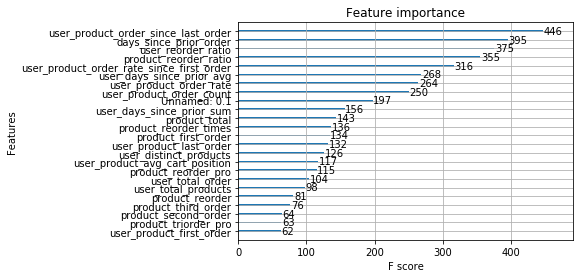

In [12]:
import xgboost
from sklearn.metrics import accuracy_score
X_train, X_val, y_train, y_val = train_test_split(Xdata,Ydata,test_size=0.8, random_state= 128)
d_train = xgboost.DMatrix(X_train, y_train)
xgb_params = {
    "objective"         : "reg:logistic"
    ,"eval_metric"      : "logloss"
    ,"eta"              : 0.1
    ,"max_depth"        : 6
    ,"min_child_weight" :10
    ,"gamma"            :0.70
    ,"subsample"        :0.76
    ,"colsample_bytree" :0.95
    ,"alpha"            :2e-05
    ,"lambda"           :10
}

watchlist= [(d_train, "train")]
bst = xgboost.train(params=xgb_params, dtrain=d_train, num_boost_round=80, evals=watchlist, verbose_eval=10)
xgboost.plot_importance(bst)

In [24]:
d_val = xgboost.DMatrix(X_val)
yhat = bst.predict(d_val)

In [20]:
# make predictions for test data
y_pred = (yhat > 0.4).astype(int)
predictions = [round(value) for value in y_pred]
# evaluate predictions
accuracy = accuracy_score(y_val, predictions)
print("Accuracy: %.6f%%" % (accuracy * 100.0))

Accuracy: 92.668203%


In [21]:
from sklearn.metrics import confusion_matrix
confusion_matrix(y_val, predictions)

array([[6204849,   77291],
       [ 419785,   77804]])

In [23]:
from sklearn.metrics import f1_score
f1_score(y_val, predictions)

0.23841246299893978

In [26]:
yhat

array([0.0209284 , 0.01816951, 0.08513519, ..., 0.01277955, 0.32339373,
       0.02845585], dtype=float32)

### Optimal Threshold for ROC Curve

Best Threshold=0.073372, G-Mean=0.747


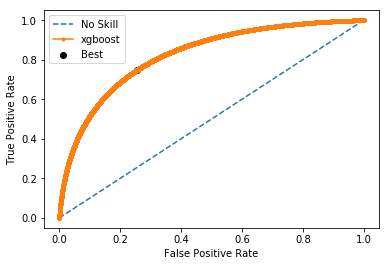

In [30]:
from sklearn.metrics import roc_curve
from matplotlib import pyplot

# calculate roc curves
fpr, tpr, thresholds = roc_curve(y_val, yhat)
# calculate the g-mean for each threshold
gmeans = np.sqrt(tpr * (1-fpr))
# locate the index of the largest g-mean
ix = np.argmax(gmeans)
print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))
# plot the roc curve for the model
pyplot.plot([0,1], [0,1], linestyle='--', label='No Skill')
pyplot.plot(fpr, tpr, marker='.', label='xgboost')
pyplot.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')
# axis labels
pyplot.xlabel('False Positive Rate')
pyplot.ylabel('True Positive Rate')
pyplot.legend()
# show the plot
pyplot.show()

### Optimal Threshold for Precision-Recall Curve

Best Threshold=0.184227, F-Score=0.376


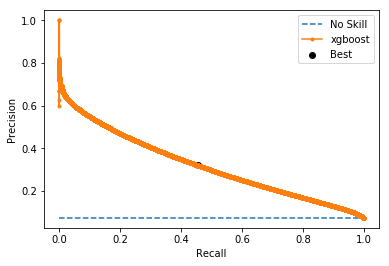

In [32]:
from sklearn.metrics import precision_recall_curve
from matplotlib import pyplot
# calculate roc curves
precision, recall, thresholds = precision_recall_curve(y_val, yhat)
# convert to f score
fscore = (2 * precision * recall) / (precision + recall)
# locate the index of the largest f score
ix = np.argmax(fscore)
print('Best Threshold=%f, F-Score=%.3f' % (thresholds[ix], fscore[ix]))
# plot the roc curve for the model
no_skill = len(y_val[y_val==1]) / len(y_val)
pyplot.plot([0,1], [no_skill,no_skill], linestyle='--', label='No Skill')
pyplot.plot(recall, precision, marker='.', label='xgboost')
pyplot.scatter(recall[ix], precision[ix], marker='o', color='black', label='Best')
# axis labels
pyplot.xlabel('Recall')
pyplot.ylabel('Precision')
pyplot.legend()
# show the plot
pyplot.show()

### Optimal Threshold Tuning on F-1 Score:

In [39]:
# apply threshold to positive probabilities to create labels
def to_labels(pos_probs, threshold):
	return (pos_probs >= threshold).astype('int')

# define thresholds
thresholds = np.arange(0, 0.5, 0.01)
# evaluate each threshold
scores = [f1_score(y_val, to_labels(yhat, t)) for t in thresholds]
# get best threshold
ix = np.argmax(scores)
print('Threshold=%.3f, F-Score=%.5f' % (thresholds[ix], scores[ix]))

Threshold=0.190, F-Score=0.37544


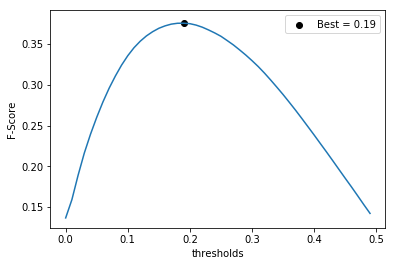

In [42]:
pyplot.plot(thresholds, scores)
pyplot.scatter(thresholds[ix], scores[ix], marker='o', color='black', label='Best = 0.19')
# axis labels
pyplot.xlabel('thresholds')
pyplot.ylabel('F-Score')
pyplot.legend()
pyplot.show()

### Fit test data into the model:

In [46]:
mydf.columns

Index(['Unnamed: 0', 'user_id', 'product_id', 'user_product_order_count',
       'user_product_first_order', 'user_product_last_order',
       'user_product_avg_cart_position', 'Unnamed: 0_x', 'product_total',
       'product_reorder', 'product_first_order', 'product_second_order',
       'product_third_order', 'product_reorder_pro', 'product_triorder_pro',
       'product_reorder_ratio', 'product_reorder_times', 'Unnamed: 0_y',
       'user_total_order', 'user_days_since_prior_sum',
       'user_days_since_prior_avg', 'user_reorder_ratio',
       'user_total_products', 'user_distinct_products', 'order_id', 'eval_set',
       'days_since_prior_order', 'user_product_order_rate',
       'user_product_order_since_last_order',
       'user_product_order_rate_since_first_order'],
      dtype='object')

In [47]:
order_products_test = pd.read_csv('./order_products__test_cap.csv')
test_data = order_products_test.merge(right=orders[['order_id', 'user_id']], how='left', on='order_id')
test_data = test_data.merge(mydf, how = 'left', on = ['user_id','product_id'])
test_data.head()

,order_id_x,product_id,user_id,Unnamed: 0,user_product_order_count,user_product_first_order,user_product_last_order,user_product_avg_cart_position,Unnamed: 0_x,product_total,...,user_days_since_prior_avg,user_reorder_ratio,user_total_products,user_distinct_products,order_id_y,eval_set,days_since_prior_order,user_product_order_rate,user_product_order_since_last_order,user_product_order_rate_since_first_order
0,1,49302,112108,11579289.0,2.0,1.0,2.0,2.5,49291.0,163.0,...,10.076923,0.692308,21.0,12.0,1.0,train,9.0,0.666667,1.0,0.666667
1,1,11109,112108,11579284.0,2.0,1.0,2.0,4.0,11105.0,4472.0,...,10.076923,0.692308,21.0,12.0,1.0,train,9.0,0.666667,1.0,0.666667
2,1,10246,112108,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,49683,112108,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,43633,112108,11579288.0,2.0,1.0,3.0,3.5,43625.0,653.0,...,10.076923,0.692308,21.0,12.0,1.0,train,9.0,0.666667,0.0,0.666667


In [48]:
test_data.columns

Index(['Unnamed: 0', 'order_id_x', 'product_id', 'add_to_cart_order',
       'reordered', 'user_id', 'user_product_order_count',
       'user_product_first_order', 'user_product_last_order',
       'user_product_avg_cart_position', 'Unnamed: 0_x', 'product_total',
       'product_reorder', 'product_first_order', 'product_second_order',
       'product_third_order', 'product_reorder_pro', 'product_triorder_pro',
       'product_reorder_ratio', 'product_reorder_times', 'Unnamed: 0_y',
       'user_total_order', 'user_days_since_prior_sum',
       'user_days_since_prior_avg', 'user_reorder_ratio',
       'user_total_products', 'user_distinct_products', 'order_id_y',
       'eval_set', 'days_since_prior_order', 'user_product_order_rate',
       'user_product_order_since_last_order',
       'user_product_order_rate_since_first_order'],
      dtype='object')

Index(['order_id_x', 'product_id', 'user_id', 'Unnamed: 0',
       'user_product_order_count', 'user_product_first_order',
       'user_product_last_order', 'user_product_avg_cart_position',
       'Unnamed: 0_x', 'product_total', 'product_reorder',
       'product_first_order', 'product_second_order', 'product_third_order',
       'product_reorder_pro', 'product_triorder_pro', 'product_reorder_ratio',
       'product_reorder_times', 'Unnamed: 0_y', 'user_total_order',
       'user_days_since_prior_sum', 'user_days_since_prior_avg',
       'user_reorder_ratio', 'user_total_products', 'user_distinct_products',
       'order_id_y', 'eval_set', 'days_since_prior_order',
       'user_product_order_rate', 'user_product_order_since_last_order',
       'user_product_order_rate_since_first_order'],
      dtype='object')

In [49]:
test_data.drop(['Unnamed: 0','order_id_y', 'Unnamed: 0_x','eval_set', 'user_id', 'Unnamed: 0_y', 'product_id', 'order_id_x'], axis=1, inplace=True)
test_data.shape

(346102, 23)

In [41]:
test_data

,add_to_cart_order,reordered,user_product_order_count,user_product_first_order,user_product_last_order,user_product_avg_cart_position,product_total,product_reorder,product_first_order,product_second_order,...,user_total_order,user_days_since_prior_sum,user_days_since_prior_avg,user_reorder_ratio,user_total_products,user_distinct_products,days_since_prior_order,user_product_order_rate,user_product_order_since_last_order,user_product_order_rate_since_first_order
0,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,1,15.0,2.0,21.0,4.733333,56087.0,45558.0,6561.0,4956.0,...,22.0,3058.0,17.179775,0.483146,187.0,101.0,30.0,0.681818,1.0,0.714286
2,3,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,1,3.0,5.0,8.0,7.000000,15298.0,9776.0,2566.0,1573.0,...,22.0,3058.0,17.179775,0.483146,187.0,101.0,30.0,0.136364,14.0,0.166667
4,5,1,1.0,15.0,15.0,5.000000,1073.0,759.0,156.0,108.0,...,22.0,3058.0,17.179775,0.483146,187.0,101.0,30.0,0.045455,7.0,0.125000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1038510,3,1,18.0,3.0,28.0,7.166667,13727.0,10385.0,1901.0,1366.0,...,29.0,2173.0,6.964744,0.775641,325.0,83.0,4.0,0.620690,1.0,0.666667
1038511,4,1,7.0,1.0,22.0,9.142857,234.0,133.0,42.0,28.0,...,29.0,2173.0,6.964744,0.775641,325.0,83.0,4.0,0.241379,7.0,0.241379
1038512,1,1,5.0,1.0,13.0,2.400000,57895.0,43875.0,8244.0,5756.0,...,14.0,337.0,13.480000,0.760000,30.0,11.0,8.0,0.357143,1.0,0.357143
1038513,2,1,2.0,1.0,11.0,3.000000,20033.0,10503.0,3890.0,2078.0,...,14.0,337.0,13.480000,0.760000,30.0,11.0,8.0,0.142857,3.0,0.142857


In [64]:
d_test = xgboost.DMatrix(test_data)
test_data.loc[:,'reordered'] = (bst.predict(d_test) > 0.19).astype(int)

In [65]:
test_data

,user_product_order_count,user_product_first_order,user_product_last_order,user_product_avg_cart_position,product_total,product_reorder,product_first_order,product_second_order,product_third_order,product_reorder_pro,...,user_days_since_prior_sum,user_days_since_prior_avg,user_reorder_ratio,user_total_products,user_distinct_products,days_since_prior_order,user_product_order_rate,user_product_order_since_last_order,user_product_order_rate_since_first_order,reordered
0,2.0,1.0,2.0,2.500000,163.0,101.0,27.0,19.0,10.0,0.703704,...,131.0,10.076923,0.692308,21.0,12.0,9.0,0.666667,1.0,0.666667,1
1,2.0,1.0,2.0,4.000000,4472.0,3192.0,704.0,475.0,347.0,0.674716,...,131.0,10.076923,0.692308,21.0,12.0,9.0,0.666667,1.0,0.666667,1
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
4,2.0,1.0,3.0,3.500000,653.0,312.0,114.0,59.0,32.0,0.517544,...,131.0,10.076923,0.692308,21.0,12.0,9.0,0.666667,0.0,0.666667,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
346097,11.0,4.0,19.0,3.181818,1169.0,563.0,176.0,82.0,53.0,0.465909,...,1835.0,11.121212,0.642424,181.0,75.0,15.0,0.578947,0.0,0.687500,1
346098,1.0,15.0,15.0,10.000000,262.0,129.0,41.0,25.0,18.0,0.609756,...,1835.0,11.121212,0.642424,181.0,75.0,15.0,0.052632,4.0,0.200000,1
346099,1.0,15.0,15.0,9.000000,322.0,116.0,56.0,24.0,11.0,0.428571,...,1835.0,11.121212,0.642424,181.0,75.0,15.0,0.052632,4.0,0.200000,1
346100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
